In [153]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy 
import os
import sys
from glob import glob
import matplotlib.colors as colors
#import seaborn as sns

In [129]:
import matplotlib as mpl
mpl.rcParams['lines.linewidth'] = 3
mpl.rcParams['axes.labelsize'] = 40
mpl.rcParams['figure.figsize'] = [20,20]
plt.rcParams['figure.autolayout'] = True
mpl.rcParams['image.aspect']='auto'
mpl.rcParams['xtick.labelsize']=20
mpl.rcParams['ytick.labelsize']=20
mpl.rcParams['grid.color']='#DDDDDD'
mpl.rcParams['grid.alpha']=0.8
mpl.rcParams['grid.linestyle']='-'
#mpl.rcParams['grid.grid'] = True
#mpl.rcParams['axes.grid'] = 'White'

In [130]:
def offset_time_array(time_array,time_array_name):
    globals()[time_array_name+'_offset'] = time_array - time_array.min()

In [131]:
def process_sa_rfi_csv(mypath,filename,descriptor):
    globals()["df_file_" + descriptor] = pd.read_csv(mypath+filename,header=None)
    globals()["df_file_" + descriptor].pop(globals()["df_file_" + descriptor].columns[0])
    globals()["time_array_" + descriptor] = globals()["df_file_" + descriptor][globals()["df_file_" + descriptor].columns[0]].to_numpy()
    globals()["df_file_" + descriptor].pop(globals()["df_file_" + descriptor].columns[0])
    globals()["data_file_" + descriptor] = globals()["df_file_" + descriptor].to_numpy()

In [132]:
# def process_sa_rfi_hdr(mypath,filename,descriptor):
#     globals()["hdr_file_" + descriptor] = pd.read_csv(mypath+filename,header=None)
#     globals()["df_file_" + descriptor].pop(globals()["df_file_" + descriptor].columns[0])
#     globals()["time_array_" + descriptor] = globals()["df_file_" + descriptor][globals()["df_file_" + descriptor].columns[0]].to_numpy()
#     globals()["df_file_" + descriptor].pop(globals()["df_file_" + descriptor].columns[0])
#     globals()["data_file_" + descriptor] = globals()["df_file_" + descriptor].to_numpy()

In [133]:
def freq_to_index(freq,value):
    idx = (np.abs(freq-value)).argmin()
    return idx

In [134]:
# Spectrum_Analyzer_setting
SA_settings = {'f_start': 500e6, 'f_stop': 6500e6, 'N_points': 1001, 'res_bw' : 300e3, 'video_bw' : 1.5e6}

In [181]:
freq = np.linspace(SA_settings['f_start'],SA_settings['f_stop'],SA_settings['N_points'])
print(freq[0],freq[1],freq[-1])
print(np.size(freq))
f_res = (freq[1]-freq[0])/1e6 #MHz
print(f_res)

500000000.0 506000000.0 6500000000.0
1001
6.0


In [136]:
base_path = '/Users/mayuris/workspace/RRI_DISTORTION/APSERa/Data/GBD_RFI'

In [137]:
my_path = os.path.join(base_path, "20230324_RFI/")
#os.path.exists(my_path)

In [138]:
#header_field_zenith_230323 = "2023-03-24_122923_hdr"
#header_terrace_east_230323 = "2023-03-24_195117_hdr"
filename = "2023-03-24_122923.csv"
descriptor = "field_zenith_240323"
process_sa_rfi_csv(my_path,filename,descriptor)

filename = "2023-03-24_195117.csv"
descriptor = "terrace_east_240323"
process_sa_rfi_csv(my_path,filename,descriptor)

filename = "2023-03-24_212300.csv"
descriptor = "terrace_south_240323"
process_sa_rfi_csv(my_path,filename,descriptor)

filename = "2023-03-25_021648.csv"
descriptor = "terrace_zenith_250323"
process_sa_rfi_csv(my_path,filename,descriptor)

filename = "2023-03-25_104503.csv"
descriptor = "field_east_250323"
process_sa_rfi_csv(my_path,filename,descriptor)

In [139]:
offset_time_array(time_array_field_zenith_240323,"time_array_field_zenith_240323")
offset_time_array(time_array_terrace_east_240323,"time_array_terrace_east_240323")
offset_time_array(time_array_terrace_south_240323,"time_array_terrace_south_240323")
offset_time_array(time_array_terrace_zenith_250323,"time_array_terrace_zenith_250323")
offset_time_array(time_array_field_east_250323,"time_array_field_east_250323")

In [140]:
index_3GHz = freq_to_index(freq,3e9)
index_4GHz = freq_to_index(freq,4e9)
index_2p5GHz = freq_to_index(freq,2.5e9)
index_2p65GHz = freq_to_index(freq,2.65e9)
index_4GHz = freq_to_index(freq,4e9)
index_2p7GHz = freq_to_index(freq,2.7e9)


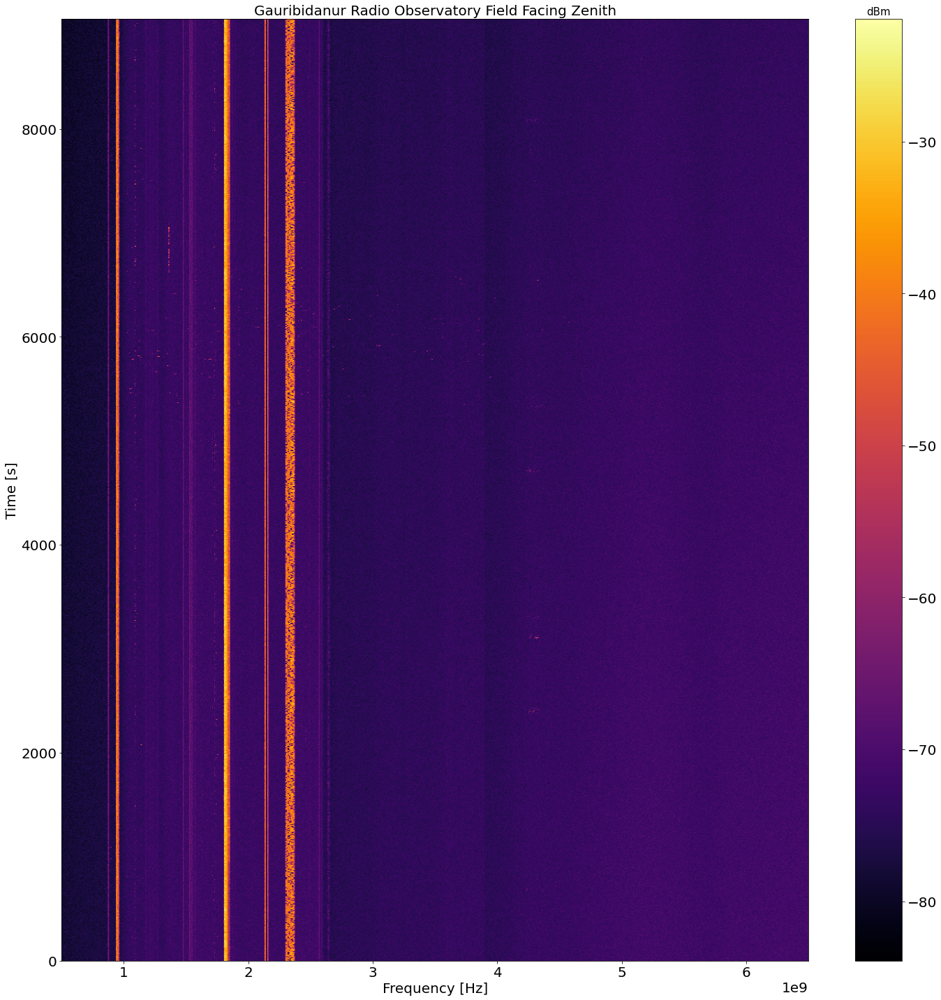

In [141]:
plt.title('Gauribidanur Radio Observatory Field Facing Zenith',size=20)
c = plt.imshow(data_file_field_zenith_240323,cmap ='inferno',extent=[freq.min(),freq.max(),time_array_field_zenith_240323_offset.min(),time_array_field_zenith_240323_offset.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

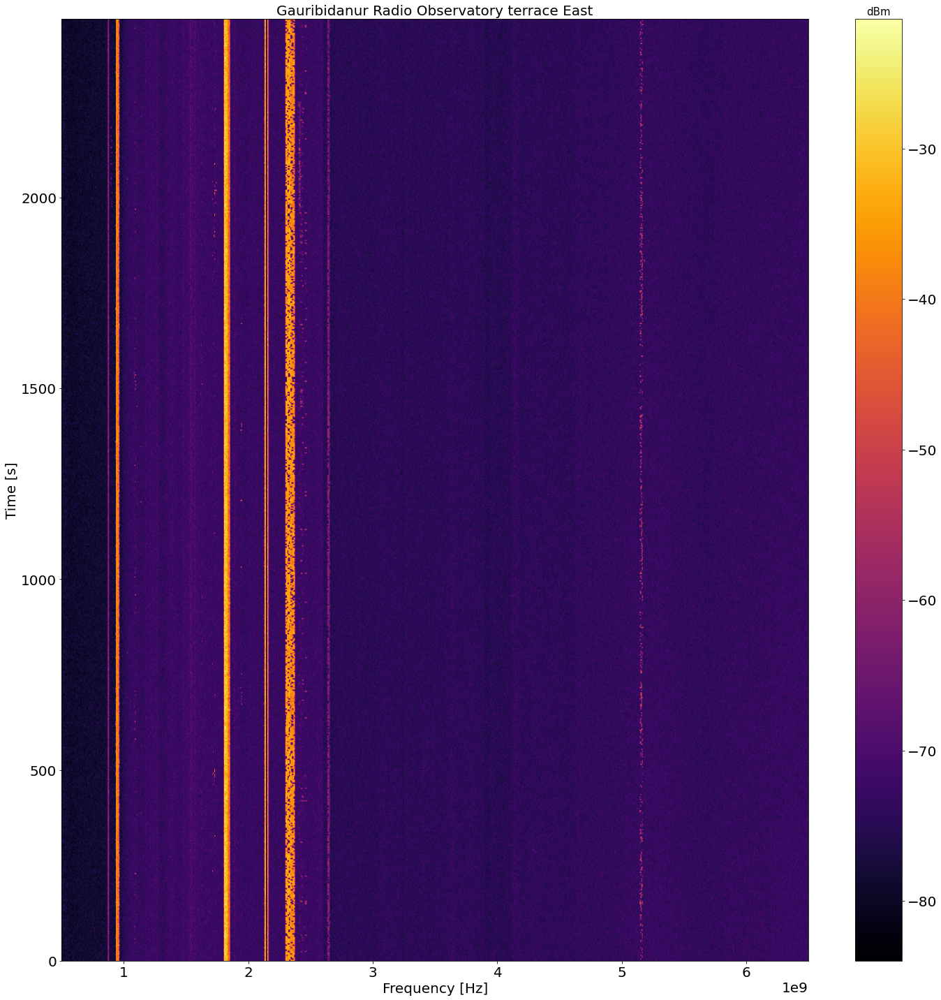

In [142]:
plt.title('Gauribidanur Radio Observatory terrace East',size=20)
c = plt.imshow(data_file_terrace_east_240323,cmap ='inferno',extent=[freq.min(),freq.max(),time_array_terrace_east_240323_offset.min(),time_array_terrace_east_240323_offset.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

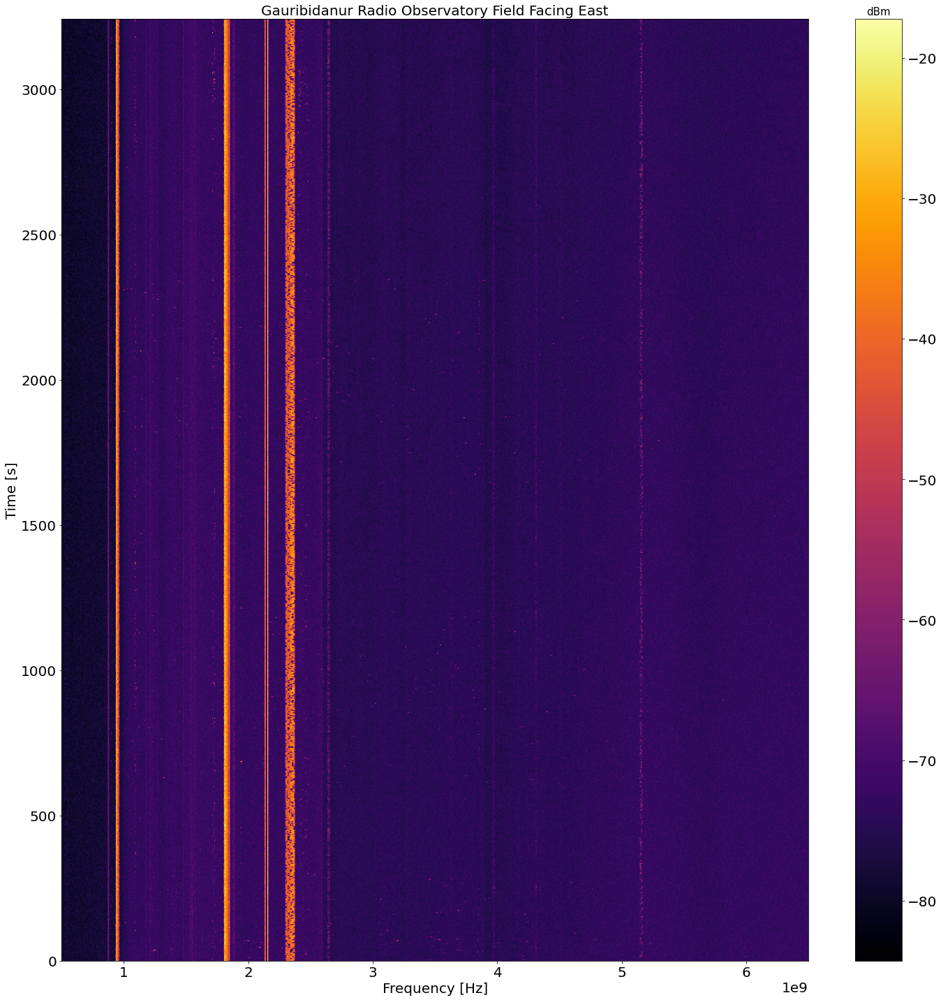

In [143]:
plt.title('Gauribidanur Radio Observatory Field Facing East',size=20)
c = plt.imshow(data_file_field_east_250323,cmap ='inferno',extent=[freq.min(),freq.max(),time_array_field_east_250323_offset.min(),time_array_field_east_250323_offset.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

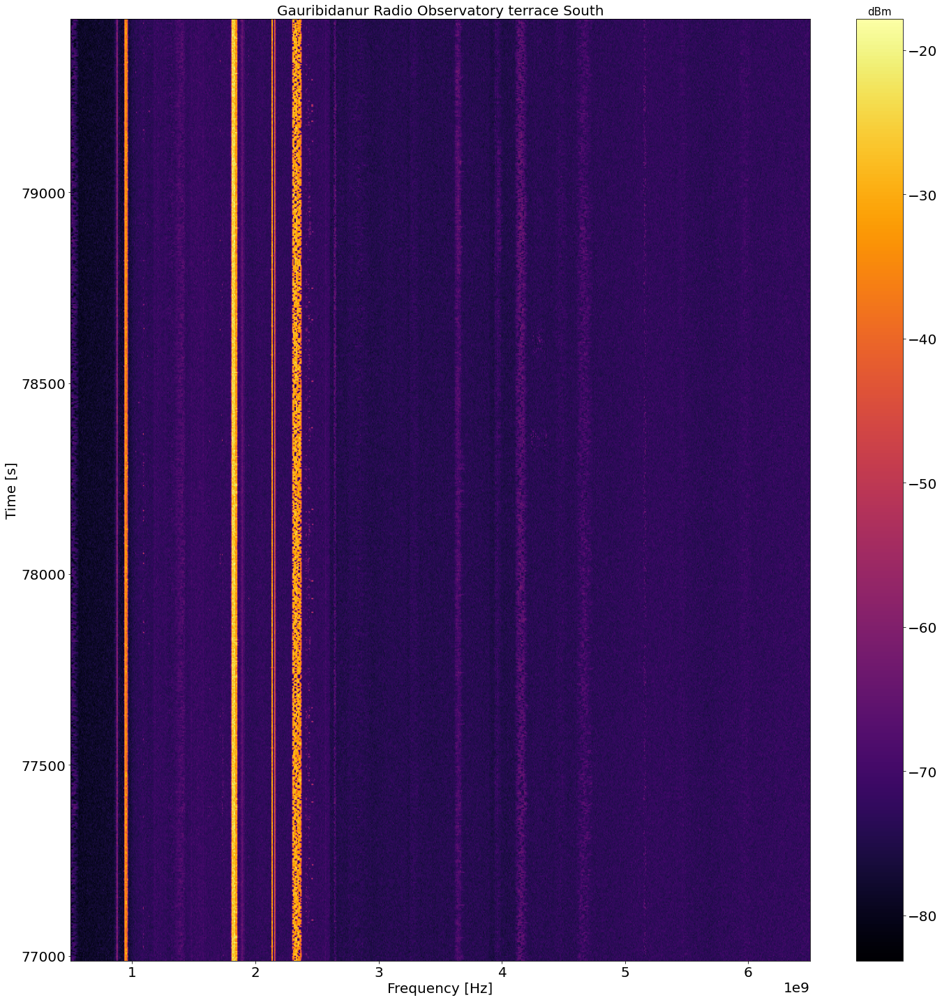

In [144]:
plt.title('Gauribidanur Radio Observatory terrace South',size=20)
c = plt.imshow(data_file_terrace_south_240323,cmap ='inferno',extent=[freq.min(),freq.max(),time_array_terrace_south_240323.min(),time_array_terrace_south_240323.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

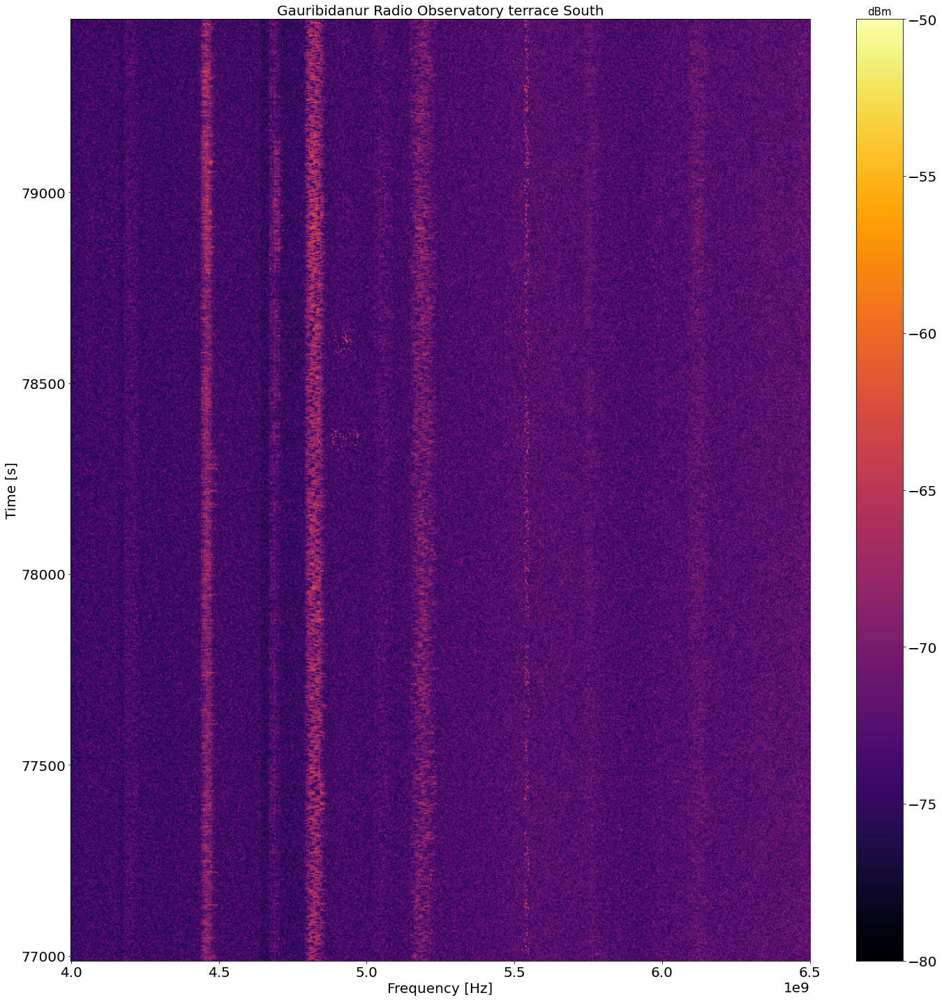

In [145]:
plt.title('Gauribidanur Radio Observatory terrace South',size=20)
c = plt.imshow(data_file_terrace_south_240323[:,index_3GHz:],vmax=-50,vmin=-80,cmap ='inferno',extent=[freq[index_4GHz],freq.max(),time_array_terrace_south_240323.min(),time_array_terrace_south_240323.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

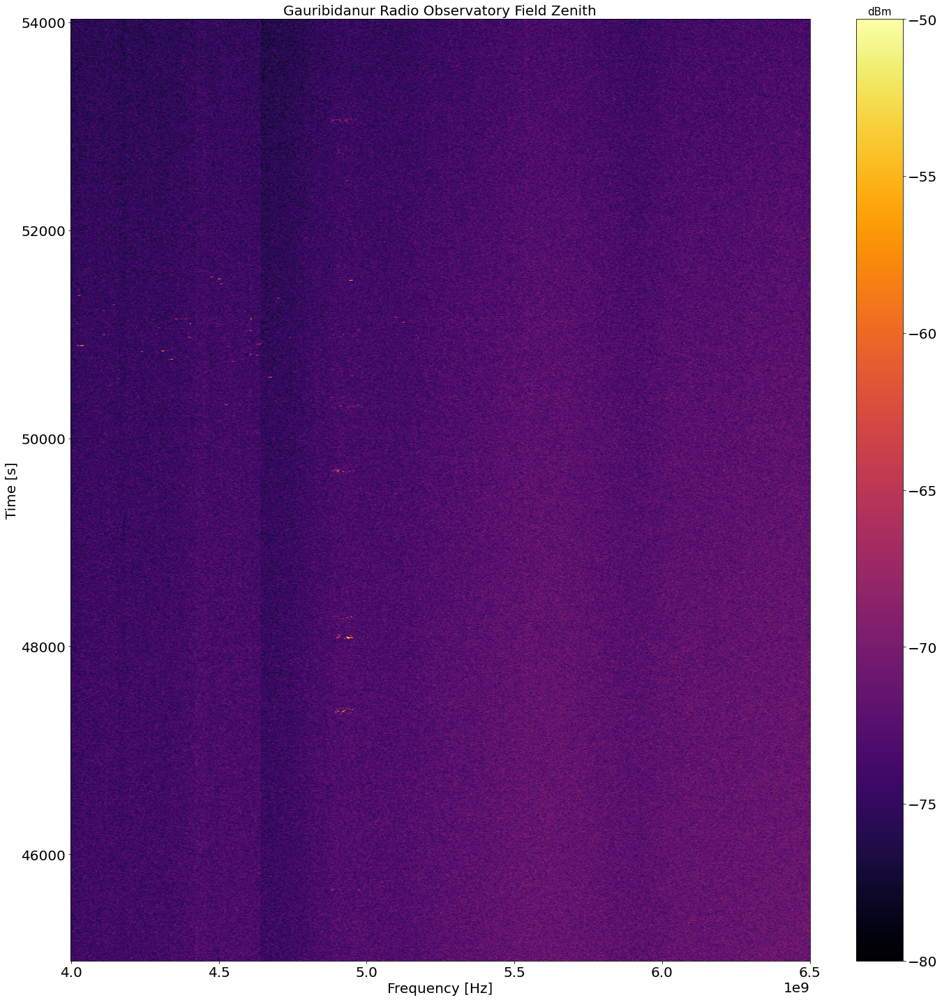

In [146]:
plt.title('Gauribidanur Radio Observatory Field Zenith',size=20)
c = plt.imshow(data_file_field_zenith_240323[:,index_3GHz:],vmax=-50,vmin=-80,cmap ='inferno',extent=[freq[index_4GHz],freq.max(),time_array_field_zenith_240323.min(),time_array_field_zenith_240323.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

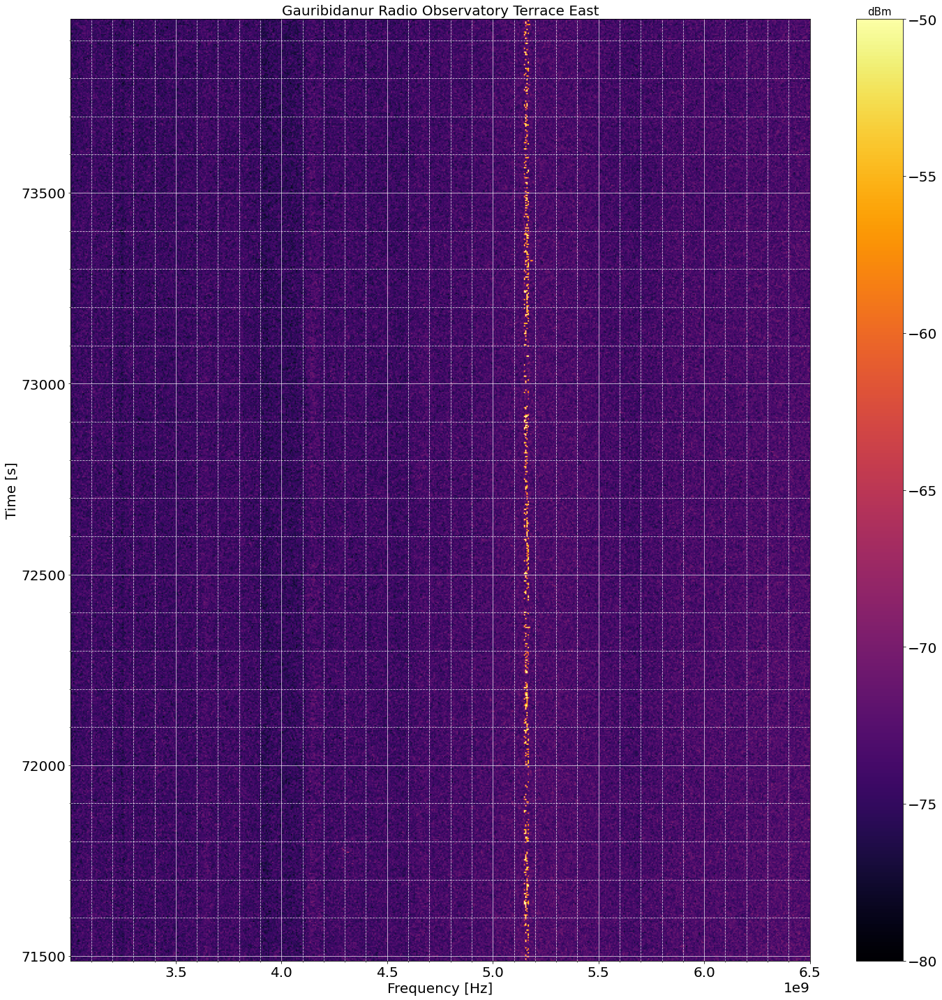

In [147]:

plt.title('Gauribidanur Radio Observatory Terrace East',size=20)
c = plt.imshow(data_file_terrace_east_240323[:,index_3GHz:],vmax=-50,vmin=-80,cmap ='inferno',extent=[freq[index_3GHz],freq.max(),time_array_terrace_east_240323.min(),time_array_terrace_east_240323.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.minorticks_on()
plt.grid(which='major',color='white',ls='-')
plt.grid(which='minor',color='white',ls='--')
plt.show()

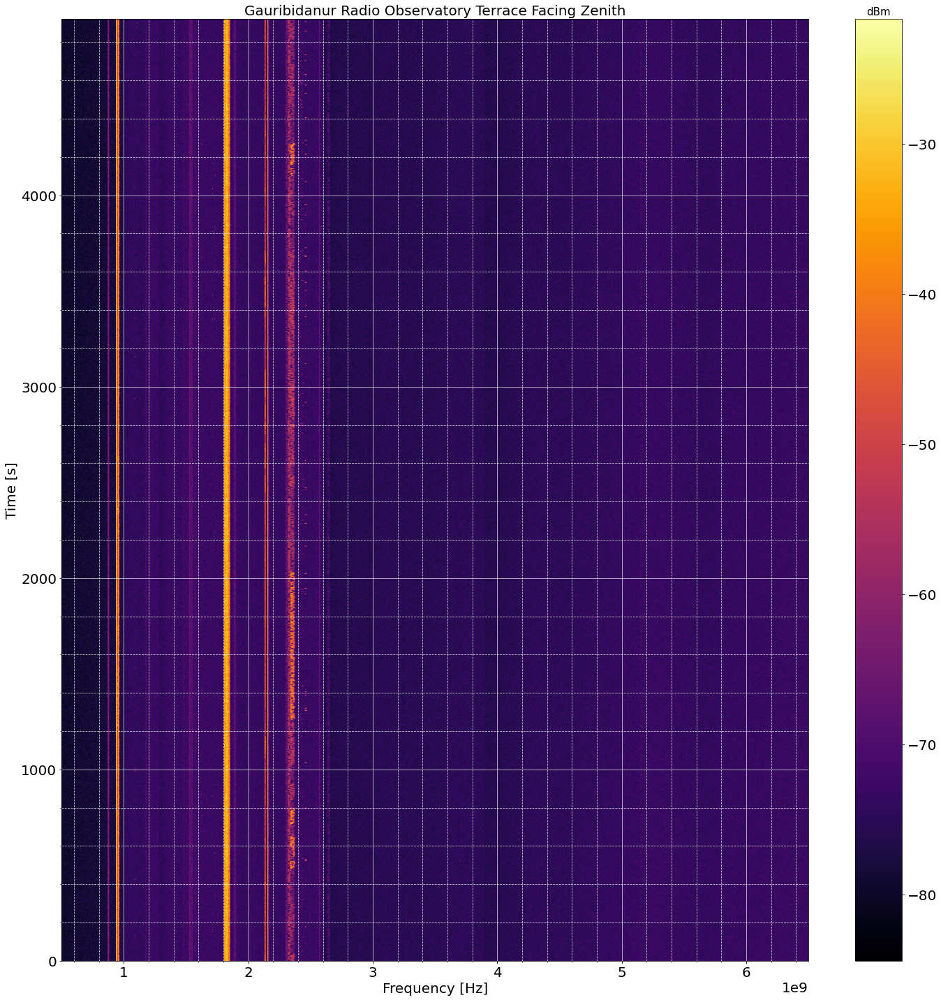

In [148]:
plt.title('Gauribidanur Radio Observatory Terrace Facing Zenith',size=20)
c = plt.imshow(data_file_terrace_zenith_250323,cmap ='inferno',extent=[freq.min(),freq.max(),time_array_terrace_zenith_250323_offset.min(),time_array_terrace_zenith_250323_offset.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.minorticks_on() 
plt.grid(True, which='major',color='white')
plt.grid(True, which='minor', color='white', linestyle='--')
plt.show()

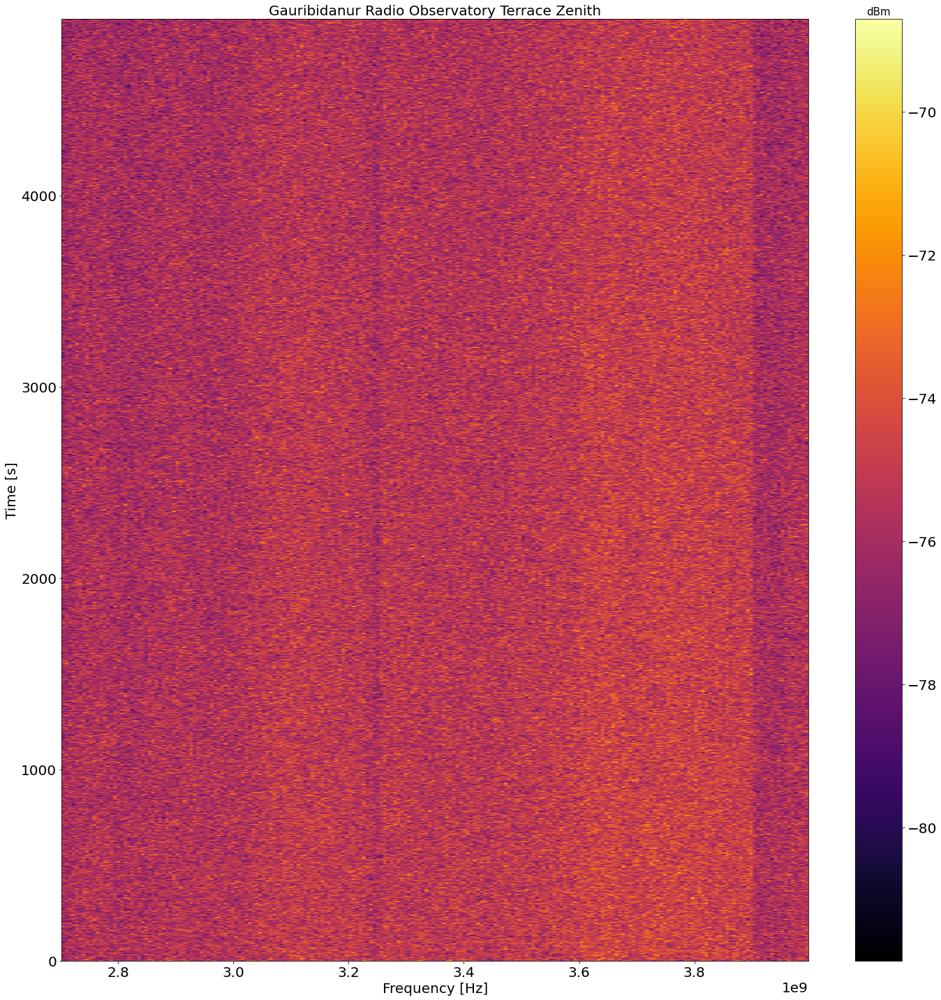

In [161]:
plt.title('Gauribidanur Radio Observatory Terrace Zenith',size=20)
c = plt.imshow(data_file_terrace_zenith_250323[:,index_2p7GHz:index_4GHz],cmap ='inferno',extent=[freq[index_2p7GHz],freq[index_4GHz],time_array_terrace_zenith_250323_offset.min(),time_array_terrace_zenith_250323_offset.max()])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.show()

In [ ]:
# df_file_terrace_zenith_250323.shape
# fig, axs = plt.subplots(nrows=334, ncols=3)
# #for i in range
#df_file_terrace_zenith_250323.hist(bins=20)

In [ ]:
# columns = list(df_file_terrace_zenith_250323)
# for i in columns:
#     df_file_terrace_zenith_250323.hist(column=i)

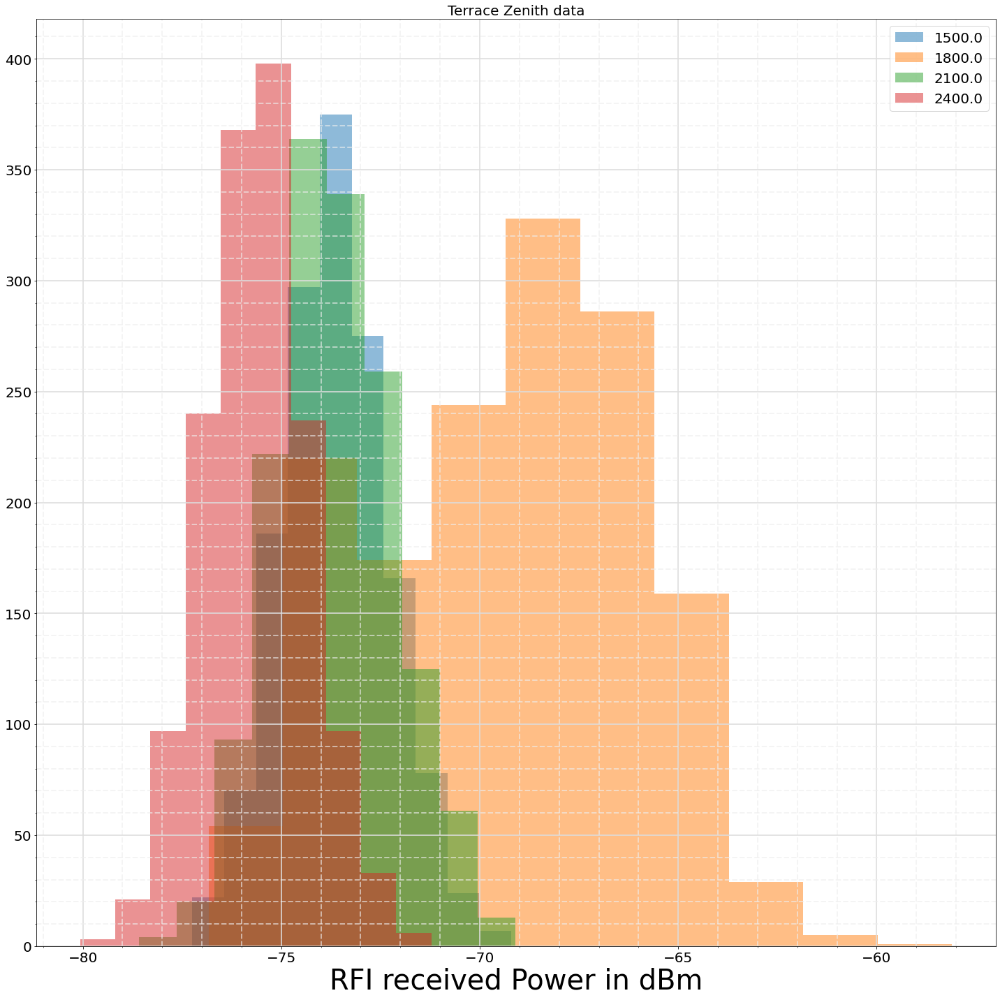

In [183]:
for i in range(index_2GHz,index_3GHz,50):
    plt.hist(df_file_terrace_zenith_250323.iloc[:,i], 
         alpha=0.5,label=i*f_res)
plt.xlabel("RFI received Power in dBm")
plt.legend(loc='upper right',fontsize=20)
plt.title('Terrace Zenith data',fontsize=20)
plt.minorticks_on() 
plt.grid(True, which='major',color='#DDDD',lw=2,alpha=0.8)
plt.grid(True, which='minor', color='#EEEE',lw=2,alpha=0.6, linestyle='--')
plt.show()
plt.show()

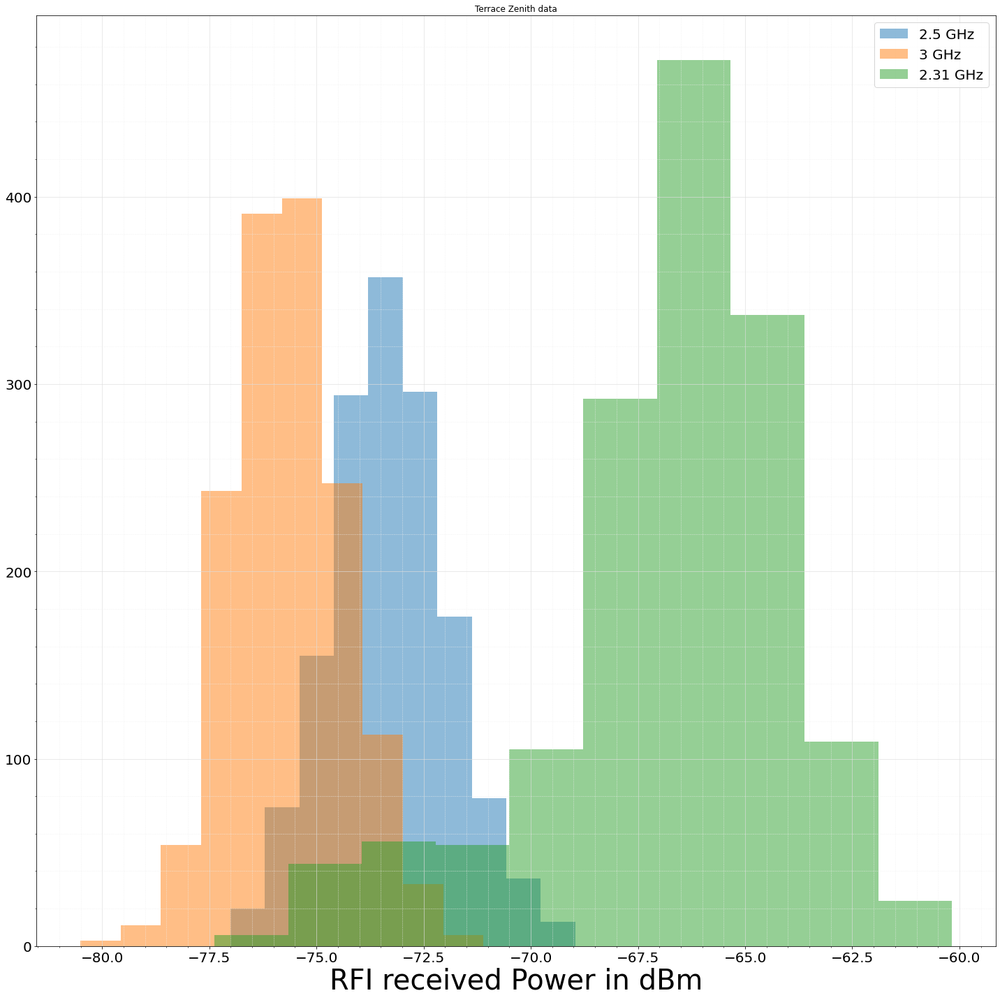

In [168]:
plt.hist(df_file_terrace_zenith_250323.iloc[:,index_2p5GHz], 
         alpha=0.5, # the transaparency parameter
         label='2.5 GHz')
plt.hist(df_file_terrace_zenith_250323.iloc[:,index_3GHz],
         alpha=0.5,
         label='3 GHz')
plt.hist(df_file_terrace_zenith_250323.iloc[:,index_2p31GHz],
         alpha=0.5,
         label='2.31 GHz')
# plt.hist(df_file_terrace_zenith_250323.iloc[:,index_3GHz],
#          alpha=0.5,
#          label='3 GHz')
plt.grid(which='major', color='#DDDDDD', linewidth=0.8)
# Show the minor grid as well. Style it in very light gray as a thin,
# dotted line.
plt.grid(which='minor', color='#EEEEEE', linestyle='--', linewidth=0.5)
# Make the minor ticks and gridlines show.
plt.minorticks_on()
plt.xlabel("RFI received Power in dBm")
plt.legend(loc='upper right',fontsize=20)
plt.title('Terrace Zenith data')
plt.show()

In [169]:
print(df_file_terrace_zenith_250323.describe())

              2            3            4            5            6     \
count  1500.000000  1500.000000  1500.000000  1500.000000  1500.000000   
mean    -78.688225   -79.577964   -79.545611   -79.610968   -79.455339   
std       1.420346     1.336523     1.339246     1.353200     1.356196   
min     -83.836555   -83.449826   -83.129036   -83.704933   -83.522206   
25%     -79.671636   -80.508235   -80.464136   -80.572889   -80.363344   
50%     -78.704279   -79.662804   -79.549237   -79.665165   -79.489948   
75%     -77.714923   -78.717752   -78.681118   -78.693987   -78.558952   
max     -73.621665   -74.221945   -74.880048   -75.431096   -74.927900   

              7            8            9            10           11    ...  \
count  1500.000000  1500.000000  1500.000000  1500.000000  1500.000000  ...   
mean    -79.389115   -79.457698   -79.276153   -79.345781   -79.417933  ...   
std       1.276885     1.306305     1.315477     1.347578     1.322384  ...   
min     -84.40230

In [170]:
print(np.shape(data_file_field_east_250323))
print(np.shape(data_file_terrace_east_240323))

(1000, 1001)
(750, 1001)


In [171]:
data_file_field_east_250323_cropped = data_file_field_east_250323[0:750,:]
print(np.shape(data_file_field_east_250323_cropped))

(750, 1001)


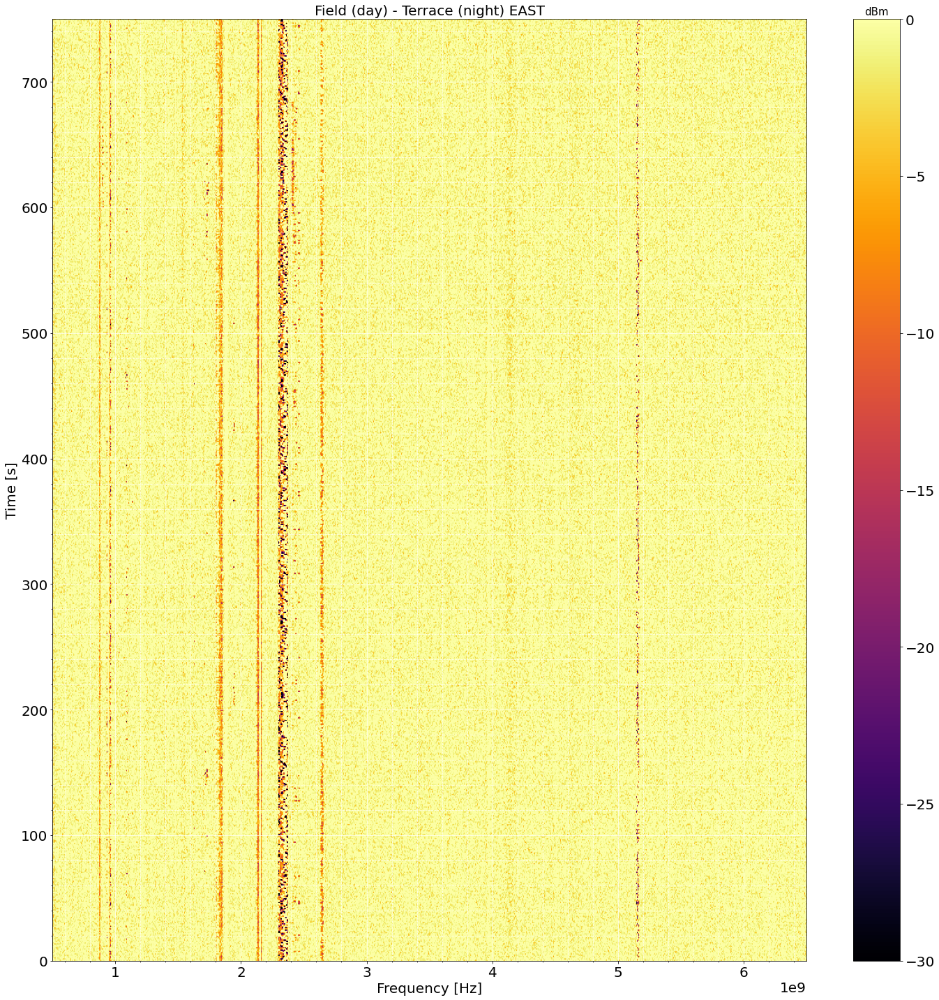

In [172]:
difference_field_minus_terrace = data_file_field_east_250323_cropped - data_file_terrace_east_240323
plt.title('Field (day) - Terrace (night) EAST',size=20)
c = plt.imshow(difference_field_minus_terrace,vmax=0,vmin=-30,cmap ='inferno',extent=[freq.min(),freq.max(),0,750])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.minorticks_on() 
plt.grid(True, which='major',color='white')
plt.grid(True, which='minor', color='white', linestyle='--')
plt.show()

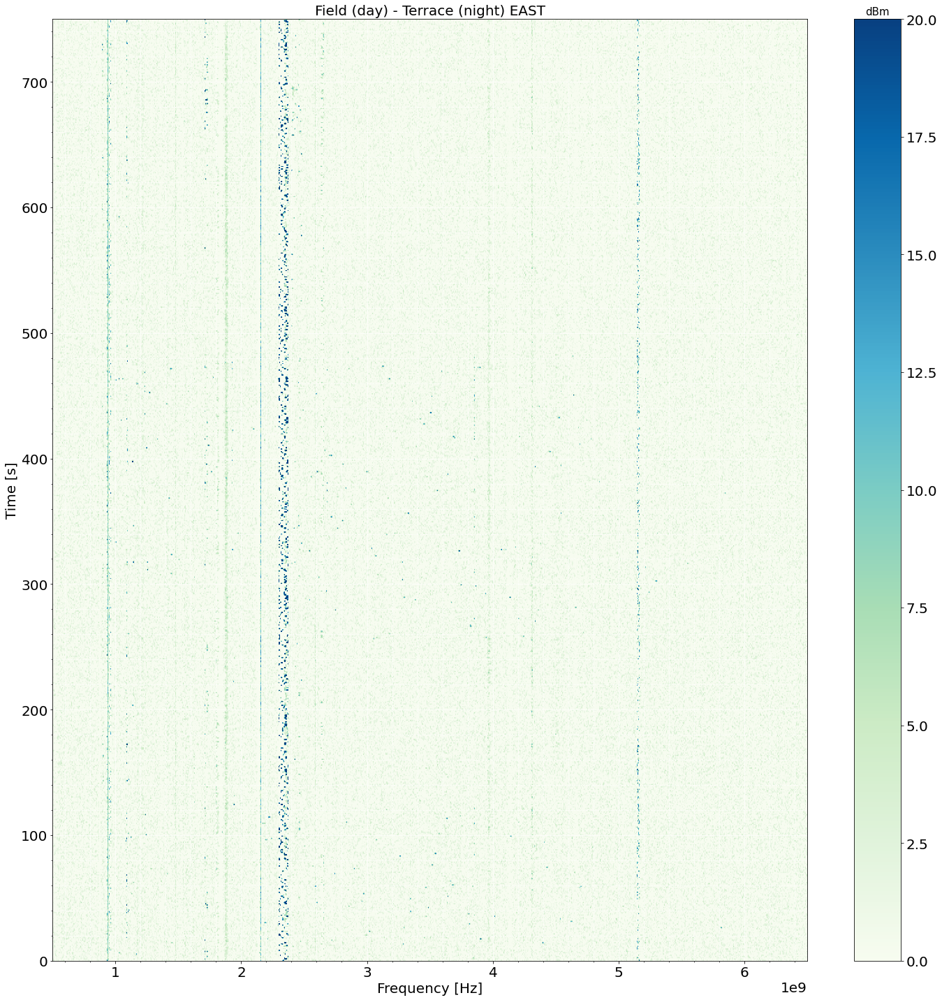

In [173]:
plt.title('Field (day) - Terrace (night) EAST',size=20)
c = plt.imshow(difference_field_minus_terrace,vmax=20,vmin=0,cmap ='GnBu',extent=[freq.min(),freq.max(),0,750])
clb = plt.colorbar(c)
clb.ax.set_title('dBm',size=15)
plt.xlabel('Frequency [Hz]',size=20)
plt.ylabel('Time [s]',size=20)
plt.minorticks_on() 
plt.grid(True, which='major',color='white')
plt.grid(True, which='minor', color='white', linestyle='--')
plt.show()